In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import pandas as pd
import anndata

from RnaVeloDataset import RnaVeloDataset
from symsimDataset import SymsimBifur, SymsimTree, SymsimBranch, SymsimLinear, SymsimCycle, SymsimTrifur, SymsimNoVeloTree, SymsimOldNoVeloTree, SymsimNewNoVeloBranch
from symsimDatasetTest import SymsimTreeNoisy, SymsimBifurNoisy, SymsimLinearNoisy
from realDataset import forebrainDataset, chromaffinDataset, forebrainDataset_large, peDataset, peDataset_large, paulDataset, oeHBCDataset
from sergioDataset import SergioBifur

from torch_geometric.data import DataLoader, Data
from model.mymodel import MyModel, GraphSAGEModel, FCModel, veloModel, DiffusionModel
import utils
import backbone

In [2]:
# dataBifur = SymsimBifur()
dataTree = SymsimTree()
datalinear = SymsimLinear()
dataDyngen = RnaVeloDataset()
forebrain = forebrainDataset()
forebrain_large = forebrainDataset_large()
chromaffin = chromaffinDataset()
pancreas = peDataset()
pancreas_large = peDataset_large()
paul = paulDataset()

dataTreeNoVelo = SymsimNoVeloTree()
dataTreeOldNoVelo = SymsimOldNoVeloTree()
dataSergio = SergioBifur()
dataTreeNoVeloBranch = SymsimNewNoVeloBranch()
dataoeHBC = oeHBCDataset()

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
Path = "./trained_model/GraphSAGE_symnewnovtreebranch_299_256_128_3_2_2_2685.pt"

# model = DiffusionModel(dataTree.num_features, hidden1 = 256, hidden2 = 128, max_diffusion = 6, include_reversed = True, device = device, dropout1=0.2, dropout2=0.2).to(device)
model = GraphSAGEModel(dataTree.num_features, device, h1 = 256, h2 = 128, dropout1 = 0.2, dropout2 = 0.2).to(device)
model.load_state_dict(torch.load(Path, map_location=torch.device('cpu')))
model.eval()

GraphSAGEModel(
  (conv1): GraphConvolutionSage (299 -> 256)
  (conv2): GraphConvolutionSage (256 -> 128)
  (lin): Linear(in_features=128, out_features=1, bias=True)
)

In [4]:
Path = "./trained_model/Diffusion_symnewnovtreebranch_256_128_3_2_2_4454.pt"
model_diff = DiffusionModel(dataTree.num_features, hidden1 = 256, hidden2 = 128, max_diffusion = 3, include_reversed = True, device = device, dropout1=0.2, dropout2=0.2).to(device)
model_diff.load_state_dict(torch.load(Path, map_location=torch.device('cpu')))
model_diff.eval()

DiffusionModel(
  (conv1): GraphDiffusion (299 -> 256)
  (conv2): GraphDiffusion (256 -> 128)
  (lin): Linear(in_features=128, out_features=1, bias=True)
)

In [5]:
Path = "./trained_model/Linear_symnewnovtreebranch_299_256_128_2_2_1758.pt"
# model = DiffusionModel(dataTree.num_features, hidden1 = 256, hidden2 = 128, max_diffusion = 6, include_reversed = True, device = device, dropout1=0.2, dropout2=0.2).to(device)
model_fc = FCModel(dataTree.num_features, device, hidden1=256, hidden2=128, dropout1=0.2, dropout2=0.2).to(device)
model_fc.load_state_dict(torch.load(Path, map_location=torch.device('cpu')))
model_fc.eval()

FCModel(
  (lin1): Linear(in_features=299, out_features=256, bias=True)
  (lin2): Linear(in_features=256, out_features=128, bias=True)
  (lin3): Linear(in_features=128, out_features=1, bias=True)
)

In [6]:
X = np.concatenate((dataTreeNoVeloBranch[3].x, dataTreeNoVeloBranch[4].x), axis=0)
# X = pca.fit_transform(X)
y = np.concatenate((dataTreeNoVeloBranch[3].y, dataTreeNoVeloBranch[4].y), axis=0)
from sklearn.kernel_ridge import KernelRidge
clf = KernelRidge(alpha=0.1)
clf.fit(X, y)

KernelRidge(alpha=0.1, coef0=1, degree=3, gamma=None, kernel='linear',
            kernel_params=None)

In [7]:
def visualize_pt(ax, pt, model, label, X_pca, fig):
    loss = "  Pearson Correlation: " + str(utils.pearson(pt, label))[:5] if len(label) else ''
    pred_sorted = sorted(pt)
    pt = [pred_sorted.index(i) for i in pt]

    pseudo_visual = ax.scatter(X_pca[:,0], X_pca[:,1], c = pt, cmap = plt.get_cmap('gnuplot'))
    fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax)    
    ax.set_title(model + loss)

def scatter(data, title, true_label=True, umap=False, dpt=True):

    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)
    if umap:
        X_pca = data.adata.obsm['X_umap']

    if true_label:
        label = data.y.cpu().numpy()[:,0]
        fig = plt.figure(figsize = (36, 5))
        ax1,ax2,ax3,ax4,ax5,ax6 = fig.subplots(1,6)
        ax6.set_title('true label')
        pseudo_visual = ax6.scatter(X_pca[:,0], X_pca[:,1], c = label, cmap = plt.get_cmap('gnuplot'))
        fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax6)
    else:
        label = []
        fig = plt.figure(figsize = (30, 5))
        ax1,ax2,ax3,ax4,ax5 = fig.subplots(1,5)

    fig.suptitle(title, fontsize=20)
    
    # Ridge
    pt = clf.predict(data.x)
    visualize_pt(ax1, pt, "ridge regression", label, X_pca, fig)

    # GraphSAGE
    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    visualize_pt(ax2, pt.detach().cpu().numpy().squeeze(), "GraphSAGE", label, X_pca, fig)

    # MLP
    pt, _, _ = model_fc(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    visualize_pt(ax3, pt.detach().cpu().numpy().squeeze(), "MLP", label, X_pca, fig)

    # DiffusionNN
    pt, _, _ = model_diff(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    visualize_pt(ax4, pt.detach().cpu().numpy().squeeze(), "DiffusionNN", label, X_pca, fig)

    # dpt
    if dpt:
        pt = data.y_vdpt[0][0]
        visualize_pt(ax5, pt, "dpt", label, X_pca, fig)

    # edges = data.edge_index.cpu().numpy()
    # for i in range(edges.shape[1]):
    #     ax4.plot(X_pca[edges[:,i]][:,0], X_pca[edges[:,i]][:,1])

# Sergio

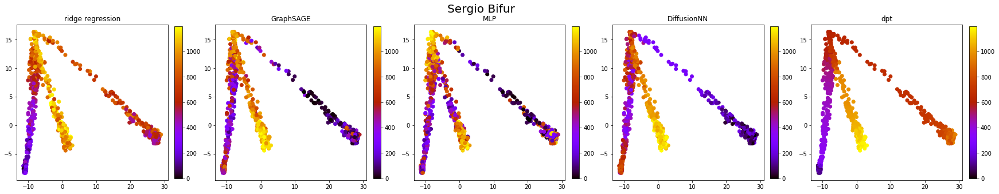

In [12]:
for data in DataLoader(dataSergio):
    scatter(data, title='Sergio Bifur', dpt=True, true_label=False)

## Symsim No Velo

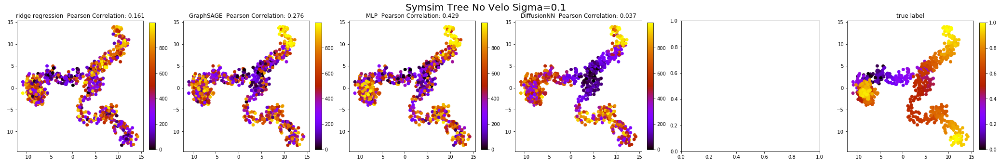

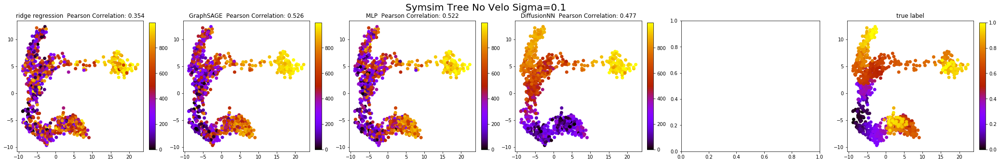

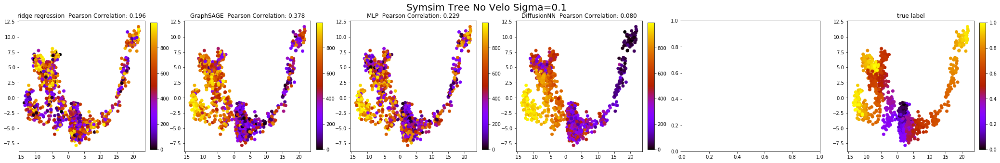

In [13]:
for data in DataLoader(dataTreeNoVelo[[8, 9, 18]]):
    scatter(data, title='Symsim Tree No Velo Sigma=0.1', dpt=False)

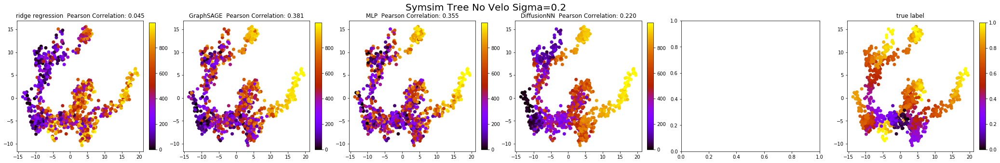

In [14]:
for data in DataLoader(dataTreeOldNoVelo[[0]]):
    scatter(data, title='Symsim Tree No Velo Sigma=0.2', dpt=False)

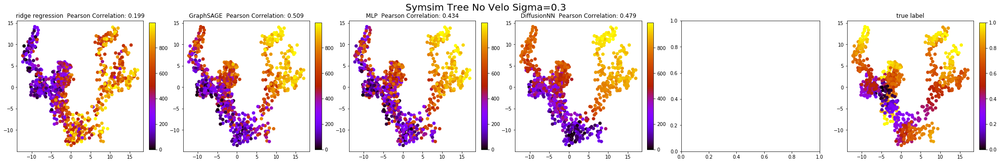

In [15]:
for data in DataLoader(dataTreeOldNoVelo[[10]]):
    scatter(data, title='Symsim Tree No Velo Sigma=0.3', dpt=False)

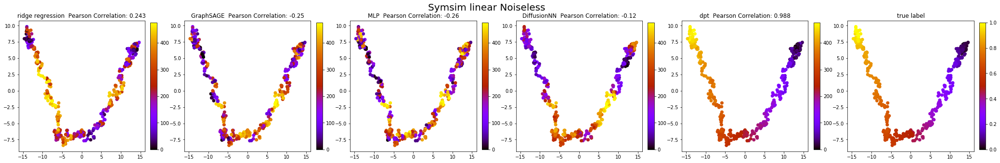

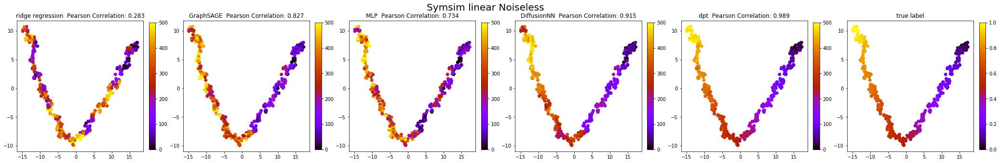

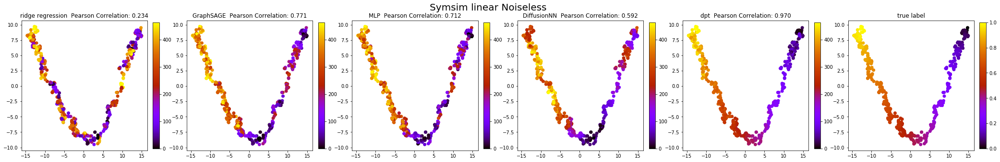

In [16]:
val_mask = [8, 9, 18]
for data in DataLoader(datalinear[val_mask]):
    scatter(data, title='Symsim linear Noiseless')

## Noiseless Symsim

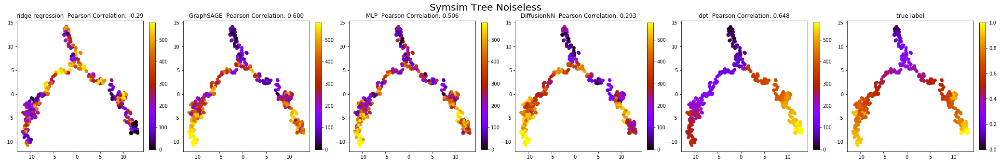

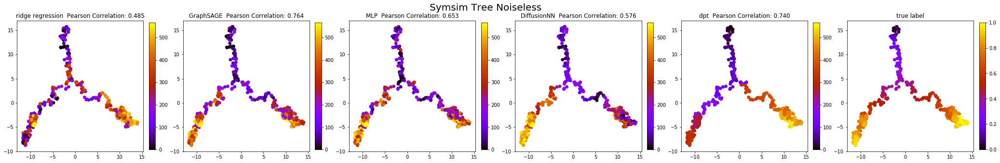

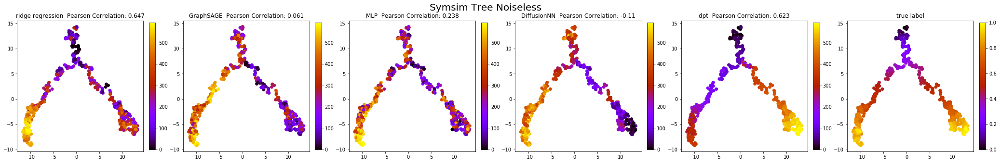

In [17]:
val_mask = [8, 9, 18]
for data in DataLoader(dataTree[val_mask]):
    scatter(data, title='Symsim Tree Noiseless')

# Dyngen dataset

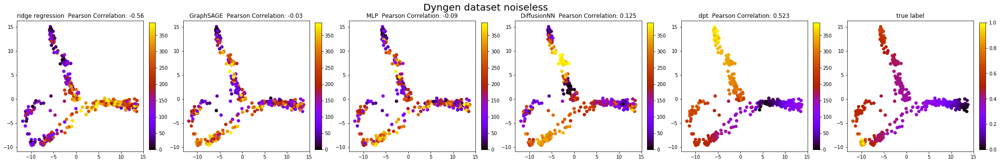

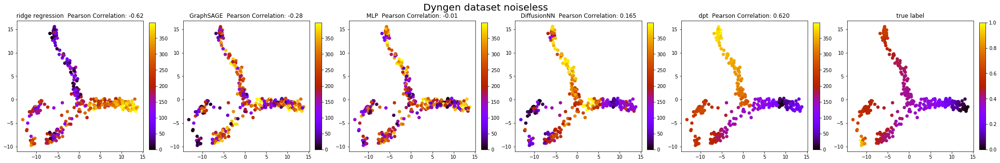

In [18]:
for data in DataLoader(dataDyngen[9, 10]):
    scatter(data, title='Dyngen dataset noiseless')

# Real

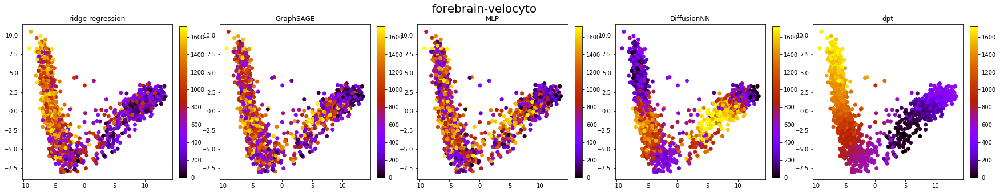

In [19]:
# without
for data in DataLoader(forebrain):
    scatter(data, title='forebrain-velocyto', true_label=False)

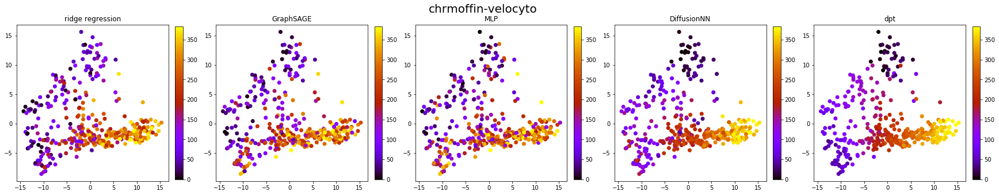

In [20]:
# without
for data in DataLoader(chromaffin):
    scatter(data, title='chrmoffin-velocyto', true_label=False)

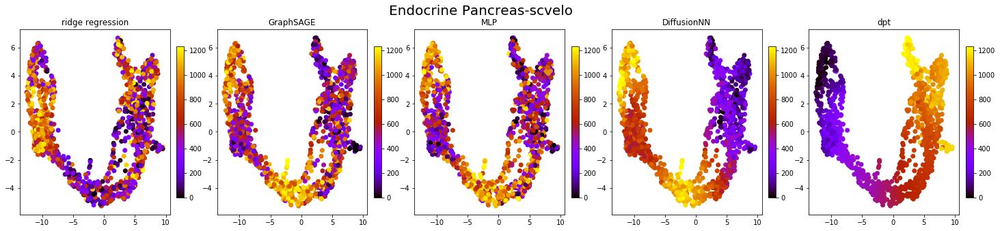

In [21]:
# without
for data in DataLoader(pancreas):
    adata = anndata.read_h5ad('./data/real_dataset/endocrinogenesis_day15.h5ad')  

    adata = adata[::3]
    X_pca = adata.obsm['X_umap']

    fig = plt.figure(figsize = (25, 5))
    ax1,ax2,ax3,ax4,ax5 = fig.subplots(1,5)

    fig.suptitle('Endocrine Pancreas-scvelo', fontsize=20)
    
    # Ridge
    pt = clf.predict(data.x)
    visualize_pt(ax1, pt, "ridge regression", [], X_pca, fig)

    # GraphSAGE
    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    visualize_pt(ax2, pt, "GraphSAGE", [], X_pca, fig) 

    # MLP
    pt, _, _ = model_fc(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    visualize_pt(ax3, pt, "MLP", [], X_pca, fig)

    # DiffusionNN
    pt, _, _ = model_diff(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    visualize_pt(ax4, pt.detach().cpu().numpy().squeeze(), "DiffusionNN", [], X_pca, fig)

    #dpt
    pt = data.y_vdpt[0][0]
    visualize_pt(ax5, pt, "dpt", [], X_pca, fig)

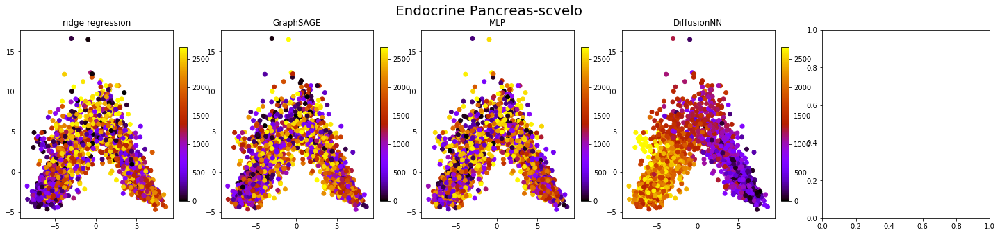

In [22]:
# without
for data in DataLoader(paul):
    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)

    fig = plt.figure(figsize = (25, 5))
    ax1,ax2,ax3,ax4,ax5 = fig.subplots(1,5)

    fig.suptitle('Endocrine Pancreas-scvelo', fontsize=20)
    
    # Ridge
    pt = clf.predict(data.x)
    visualize_pt(ax1, pt, "ridge regression", [], X_pca, fig)

    # GraphSAGE
    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    visualize_pt(ax2, pt, "GraphSAGE", [], X_pca, fig) 

    # MLP
    pt, _, _ = model_fc(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    visualize_pt(ax3, pt, "MLP", [], X_pca, fig)

    # DiffusionNN
    pt, _, _ = model_diff(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    visualize_pt(ax4, pt.detach().cpu().numpy().squeeze(), "DiffusionNN", [], X_pca, fig)

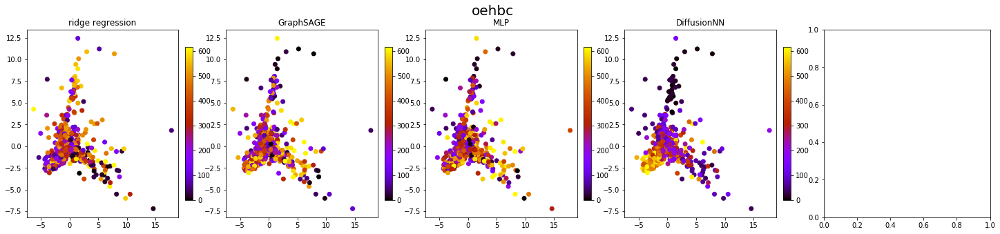

In [8]:
# without
for data in DataLoader(dataoeHBC):
    X_pca = utils.pca_op(data.x.detach().numpy(), standardize=False)

    fig = plt.figure(figsize = (25, 5))
    ax1,ax2,ax3,ax4,ax5 = fig.subplots(1,5)

    fig.suptitle('oehbc', fontsize=20)
    
    # Ridge
    pt = clf.predict(data.x)
    visualize_pt(ax1, pt, "ridge regression", [], X_pca, fig)

    # GraphSAGE
    pt, _, _ = model(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    visualize_pt(ax2, pt, "GraphSAGE", [], X_pca, fig) 

    # MLP
    pt, _, _ = model_fc(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    pt = pt.detach().cpu().numpy().squeeze()
    visualize_pt(ax3, pt, "MLP", [], X_pca, fig)

    # DiffusionNN
    pt, _, _ = model_diff(data.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
    visualize_pt(ax4, pt.detach().cpu().numpy().squeeze(), "DiffusionNN", [], X_pca, fig)